# Linear Regression with Pytorch

We are using sciokit-learn to generate the regression dataset between salary and experience with 100 samples and 1 feature

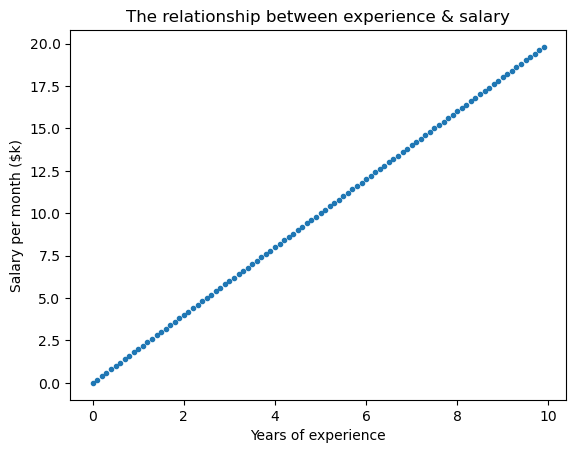

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt 
import numpy as np
import torch
import torch.nn as nn

# Creating a function f(X) with a slope of -5
x = torch.arange(0, 10, 0.1).view(-1, 1)
y = 2 * x

plt.plot(x, y, '.')
plt.xlabel('Years of experience')
plt.ylabel('Salary per month ($k)')
plt.title('The relationship between experience & salary')
plt.show()

Add a Gaussian Noise to the curve

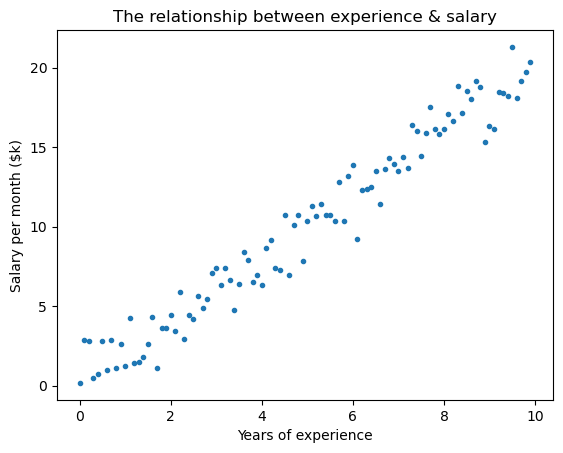

In [2]:
# Adding Gaussian noise to the function f(X) and saving it in Y
Y = y + 1.2 * torch.randn(x.size())

plt.plot(x, Y, '.')
plt.xlabel('Years of experience')
plt.ylabel('Salary per month ($k)')
plt.title('The relationship between experience & salary')
plt.show()

Split the set into train and test set

In [3]:
xTrain, xTest, yTrain, yTest = train_test_split(x, Y, test_size=0.3, random_state=0)


Build the model

In [4]:
# defining the function for forward pass for prediction
# def forward(x):
#     return w * x
class LinearRegression(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(LinearRegression, self).__init__()
        self.linear = nn.Linear(input_dim, output_dim)
        
    def forward(self, x):
        out = self.linear(x)
        return out

model = LinearRegression(1, 1)

Define the Loss class

In [5]:
criterion = nn.MSELoss()

We use the gradient descent optimization algorithm

In [6]:
learningRate = 0.001
optimizer = torch.optim.SGD(model.parameters(), lr=learningRate)

Let's train the model

In [7]:
losses = []
epochs = 100
for epoch in range(epochs):
    epoch += 1

    optimizer.zero_grad() 

    outputs = model(xTrain)

    loss = criterion(outputs, yTrain)
    losses.append(loss.item())

    loss.backward()

    optimizer.step()

    print('Epoch: {} | Loss: {}'.format(epoch, loss.item()))

Epoch: 1 | Loss: 311.1671447753906
Epoch: 2 | Loss: 271.3742370605469
Epoch: 3 | Loss: 236.69715881347656
Epoch: 4 | Loss: 206.4781494140625
Epoch: 5 | Loss: 180.14410400390625
Epoch: 6 | Loss: 157.19554138183594
Epoch: 7 | Loss: 137.197265625
Epoch: 8 | Loss: 119.76996612548828
Epoch: 9 | Loss: 104.5831298828125
Epoch: 10 | Loss: 91.34870910644531
Epoch: 11 | Loss: 79.81571197509766
Epoch: 12 | Loss: 69.76537322998047
Epoch: 13 | Loss: 61.00712966918945
Epoch: 14 | Loss: 53.37483215332031
Epoch: 15 | Loss: 46.72373962402344
Epoch: 16 | Loss: 40.927711486816406
Epoch: 17 | Loss: 35.87681579589844
Epoch: 18 | Loss: 31.475257873535156
Epoch: 19 | Loss: 27.639562606811523
Epoch: 20 | Loss: 24.296987533569336
Epoch: 21 | Loss: 21.384124755859375
Epoch: 22 | Loss: 18.845739364624023
Epoch: 23 | Loss: 16.633684158325195
Epoch: 24 | Loss: 14.706006050109863
Epoch: 25 | Loss: 13.02614974975586
Epoch: 26 | Loss: 11.562247276306152
Epoch: 27 | Loss: 10.286539077758789
Epoch: 28 | Loss: 9.1748332

Let's visualize the Loss function

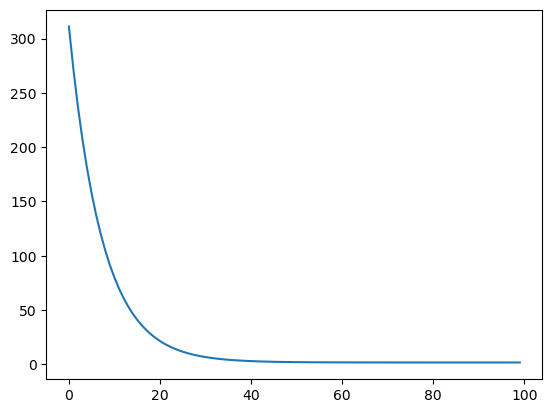

In [8]:
# Visualizing the loss data
plt.plot(range(epochs), losses)
plt.show()

The train model

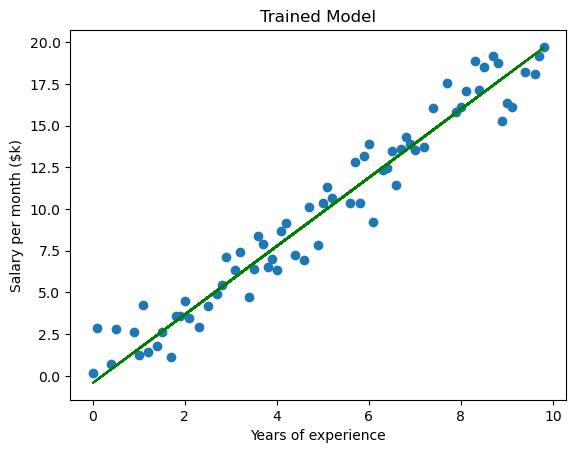

In [9]:
# Visualizing the trained model
def plotModel():
    plt.title('Trained Model')
    plt.xlabel('Years of experience')
    plt.ylabel('Salary per month ($k)')
    
    weight, bias = model.parameters()

    w = weight[0][0].item()
    b = bias[0].item()
    
    X1 = xTrain
    Y1 = w * X1 + b
    
    plt.plot(X1, Y1, 'g')
    plt.scatter(xTrain, yTrain)
    plt.show()

plotModel()

# Linear Classifier

In [3]:
# Import the required libraries 
import torch 
from sklearn.datasets import load_iris 
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

%matplotlib inline

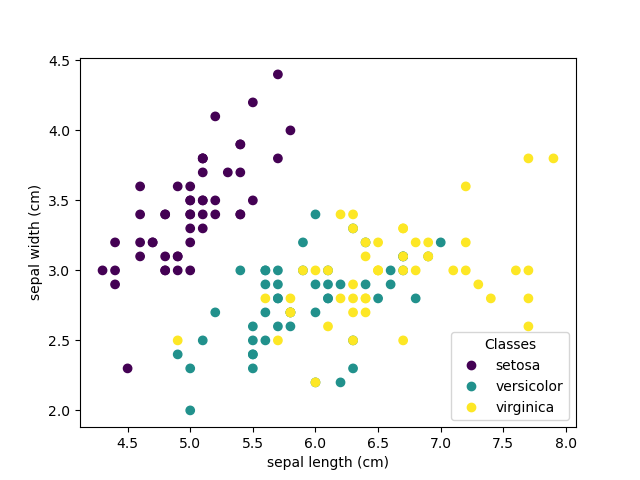

In [4]:
# Load the Iris dataset 
iris = load_iris() 

_, ax = plt.subplots()
scatter = ax.scatter(iris.data[:, 0], iris.data[:, 1], c=iris.target)
ax.set(xlabel=iris.feature_names[0], ylabel=iris.feature_names[1])
_ = ax.legend(
    scatter.legend_elements()[0], iris.target_names, loc="lower right", title="Classes"
)


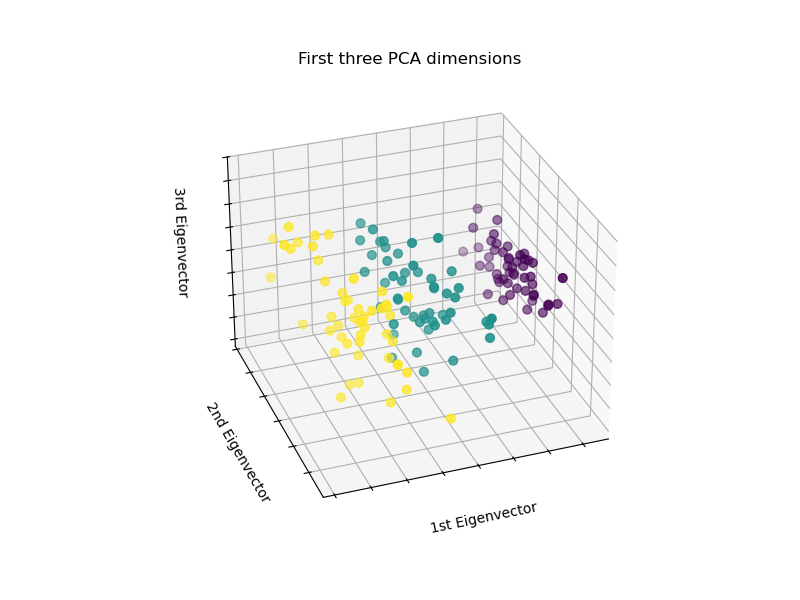

In [5]:
# unused but required import for doing 3d projections with matplotlib < 3.2
%matplotlib widget
import mpl_toolkits.mplot3d  # noqa: F401

from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_reduced = PCA(n_components=3).fit_transform(iris.data)
ax.scatter(
    X_reduced[:, 0],
    X_reduced[:, 1],
    X_reduced[:, 2],
    c=iris.target,
    s=40,
)

ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
ax.xaxis.set_ticklabels([])
ax.set_ylabel("2nd Eigenvector")
ax.yaxis.set_ticklabels([])
ax.set_zlabel("3rd Eigenvector")
ax.zaxis.set_ticklabels([])

plt.show()

In [6]:
# Split the data into training and testing sets 
X_train, X_test, y_train, y_test = train_test_split(iris.data, 
													iris.target, 
													test_size=0.2, 
													random_state=42)


In [7]:
# Convert the data to PyTorch tensors 
X_train = torch.tensor(X_train).float() 
X_test = torch.tensor(X_test).float() 
y_train = torch.tensor(y_train) 
y_test = torch.tensor(y_test) 

# Normalize the features 
mean = X_train.mean(dim=0) 
std = X_train.std(dim=0) 
X_train = (X_train - mean) / std 
X_test = (X_test - mean) / std


In [8]:
# Define the model 
model = torch.nn.Sequential( 
	torch.nn.Linear(in_features = 4, out_features =3), 
	torch.nn.Softmax(dim=1) 
)


In [9]:
# Train the model 
criterion = torch.nn.CrossEntropyLoss() 
optimizer = torch.optim.SGD(model.parameters(), lr=0.1) 

num_epochs = 10000
losses = []
for epoch in range(num_epochs): 
	# Forward pass 
	y_pred = model(X_train) 
	loss = criterion(y_pred, y_train) 

	# Backward pass and optimization 
	optimizer.zero_grad() 
	loss.backward() 
	optimizer.step() 
	losses.append(loss.item())

	# Print the loss every 100 epochs 
	if (epoch+1) % 100 == 0: 
		print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')


Epoch [100/10000], Loss: 0.7835
Epoch [200/10000], Loss: 0.7538
Epoch [300/10000], Loss: 0.7362
Epoch [400/10000], Loss: 0.7218
Epoch [500/10000], Loss: 0.7090
Epoch [600/10000], Loss: 0.6975
Epoch [700/10000], Loss: 0.6873
Epoch [800/10000], Loss: 0.6784
Epoch [900/10000], Loss: 0.6707
Epoch [1000/10000], Loss: 0.6639
Epoch [1100/10000], Loss: 0.6581
Epoch [1200/10000], Loss: 0.6529
Epoch [1300/10000], Loss: 0.6484
Epoch [1400/10000], Loss: 0.6444
Epoch [1500/10000], Loss: 0.6408
Epoch [1600/10000], Loss: 0.6376
Epoch [1700/10000], Loss: 0.6347
Epoch [1800/10000], Loss: 0.6321
Epoch [1900/10000], Loss: 0.6297
Epoch [2000/10000], Loss: 0.6275
Epoch [2100/10000], Loss: 0.6255
Epoch [2200/10000], Loss: 0.6237
Epoch [2300/10000], Loss: 0.6220
Epoch [2400/10000], Loss: 0.6204
Epoch [2500/10000], Loss: 0.6190
Epoch [2600/10000], Loss: 0.6176
Epoch [2700/10000], Loss: 0.6164
Epoch [2800/10000], Loss: 0.6152
Epoch [2900/10000], Loss: 0.6141
Epoch [3000/10000], Loss: 0.6130
Epoch [3100/10000],

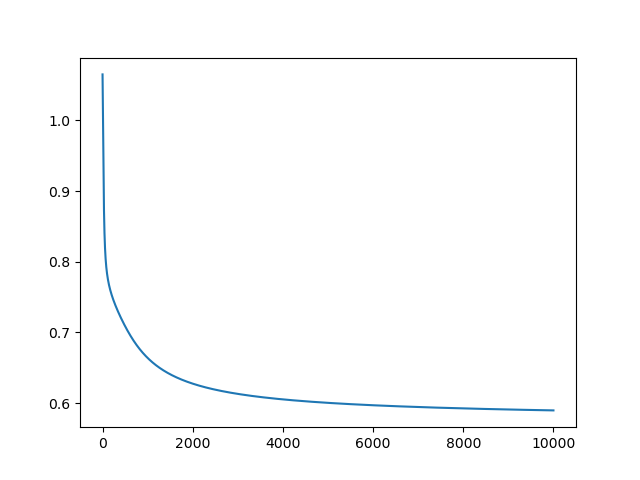

In [10]:
# Visualizing the loss data
plt.figure()
plt.plot(range(num_epochs), losses)
plt.show()

In [11]:
# Evaluate the model 
with torch.no_grad(): 
	y_pred = model(X_test) 
	_, predicted = torch.max(y_pred, dim=1) 
	accuracy = (predicted == y_test).float().mean() 
	print(f'Test Accuracy: {accuracy.item():.4f}')


Test Accuracy: 0.9667


([], [])

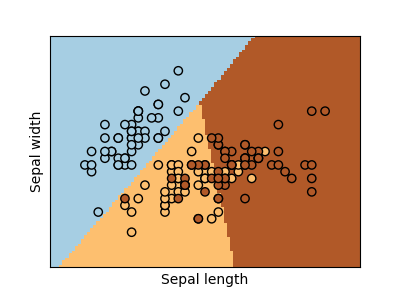

In [12]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.linear_model import LogisticRegression
X = iris.data[:, :2]  # we only take the first two features.
Y = iris.target

# Create an instance of Logistic Regression Classifier and fit the data.
logreg = LogisticRegression(C=1e5)
logreg.fit(X, Y)

_, ax = plt.subplots(figsize=(4, 3))
DecisionBoundaryDisplay.from_estimator(
    logreg,
    X,
    cmap=plt.cm.Paired,
    ax=ax,
    response_method="predict",
    plot_method="pcolormesh",
    shading="auto",
    xlabel="Sepal length",
    ylabel="Sepal width",
    eps=0.5,
)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=Y, edgecolors="k", cmap=plt.cm.Paired)


plt.xticks(())
plt.yticks(())

# Decision Tree Classifier

In [13]:
# Load libraries
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation


In [14]:
col_names = ['pregnant', 'glucose', 'bp', 'skin', 'insulin', 'bmi', 'pedigree', 'age', 'label']
# load dataset
pima = pd.read_csv("diabetes.csv", header=0, names=col_names)


In [15]:
pima.head()


,pregnant,glucose,bp,skin,insulin,bmi,pedigree,age,label
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [16]:
# Feature Selection

#split dataset in features and target variable
feature_cols = ['pregnant', 'insulin', 'bmi', 'age','glucose','bp','pedigree']
X = pima[feature_cols] # Features
y = pima.label # Target variable


In [17]:
# Splitting the data

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) # 70% training and 30% test


In [18]:
# Building a Decision tree model

# Create Decision Tree classifer object
clf = DecisionTreeClassifier()

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)


In [19]:
# Evaluating the model

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.683982683982684


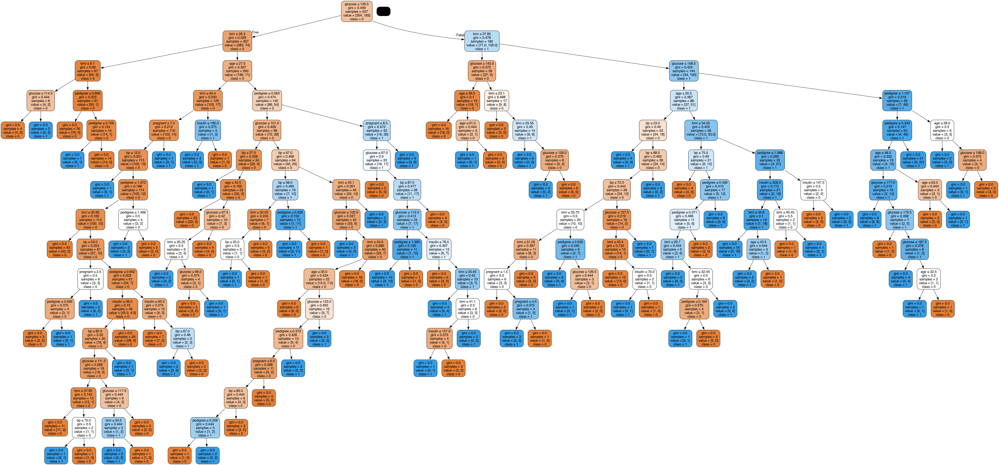

In [20]:
# !pip install graphviz
# !pip install pydotplus

from sklearn.tree import export_graphviz
from six import StringIO  
from IPython.display import Image  
import pydotplus

dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())


# Random Forest Classifier

In [21]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import preprocessing
import seaborn as sbs

sbs.set_theme()

# %matplotlib widget
%matplotlib inline

In [22]:
df = pd.read_csv("./diabetes.csv")
df.head()



,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [24]:
df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [25]:
df[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']] = df[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']].replace(0, np.NaN)

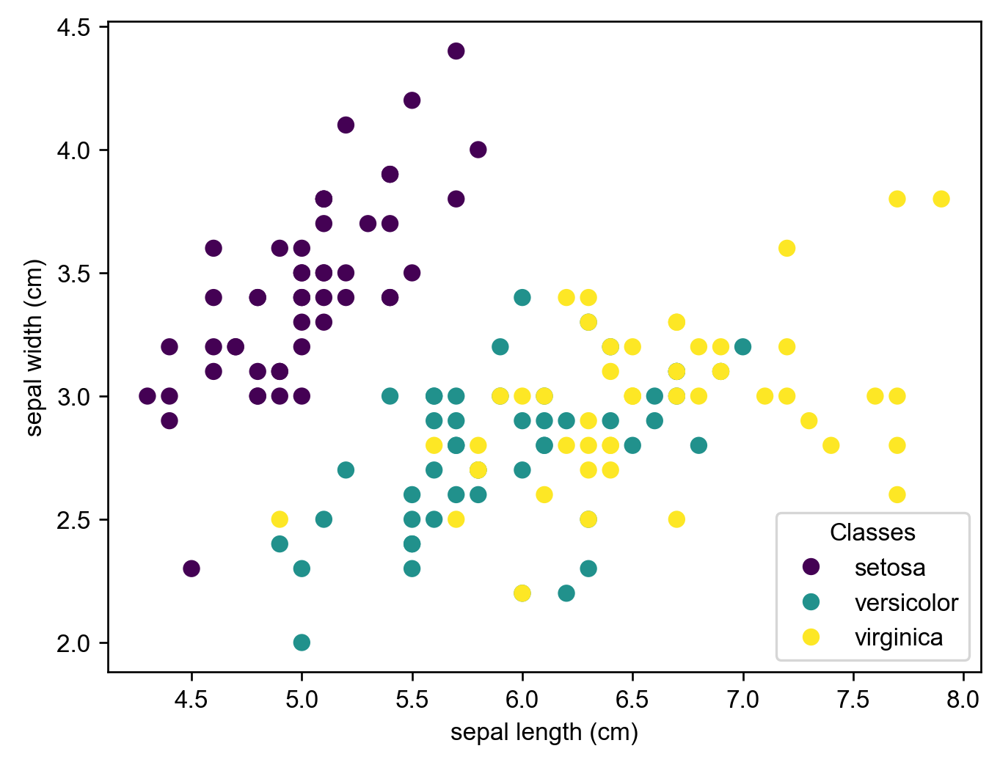

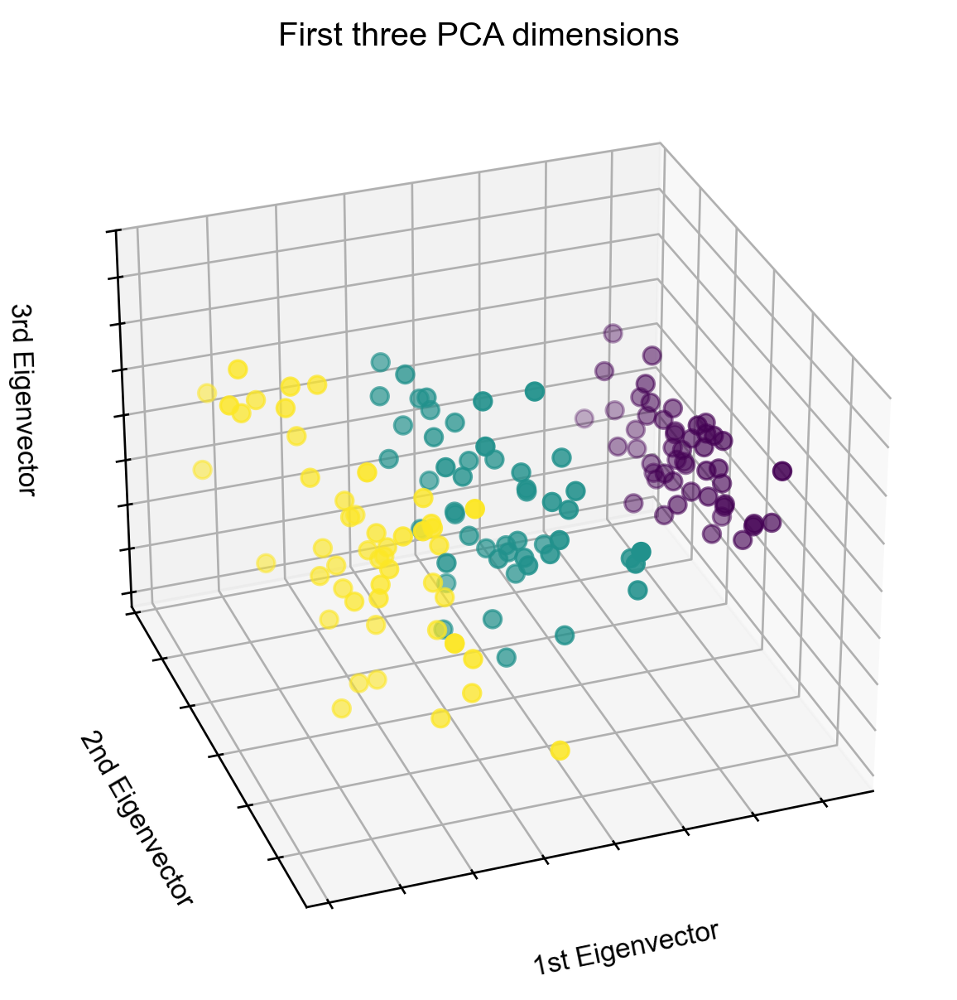

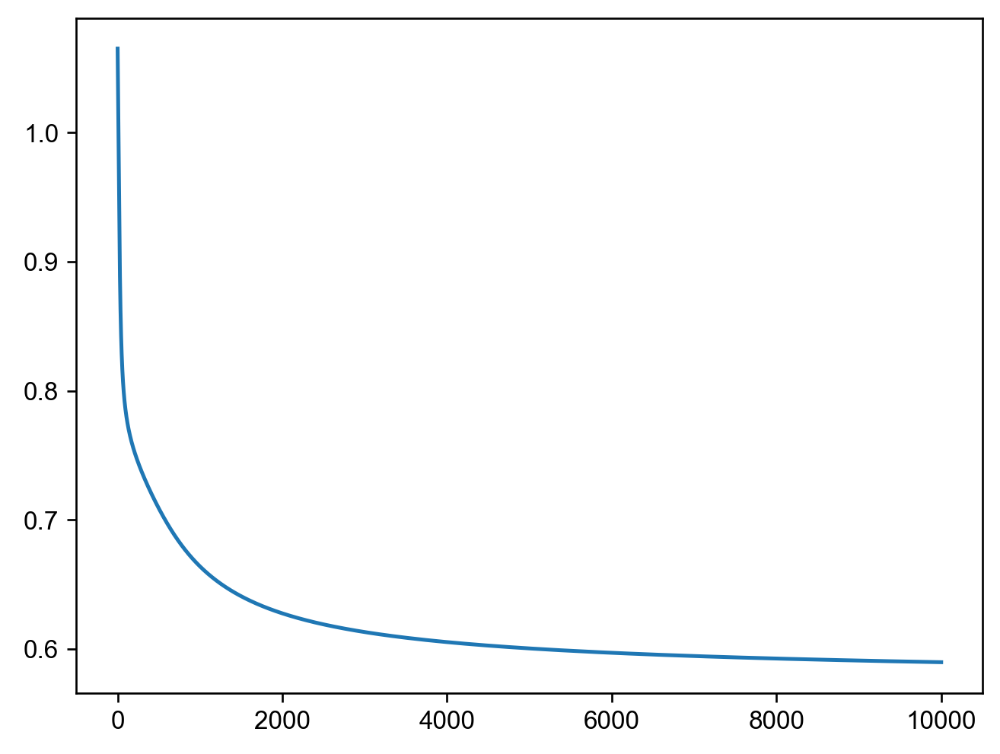

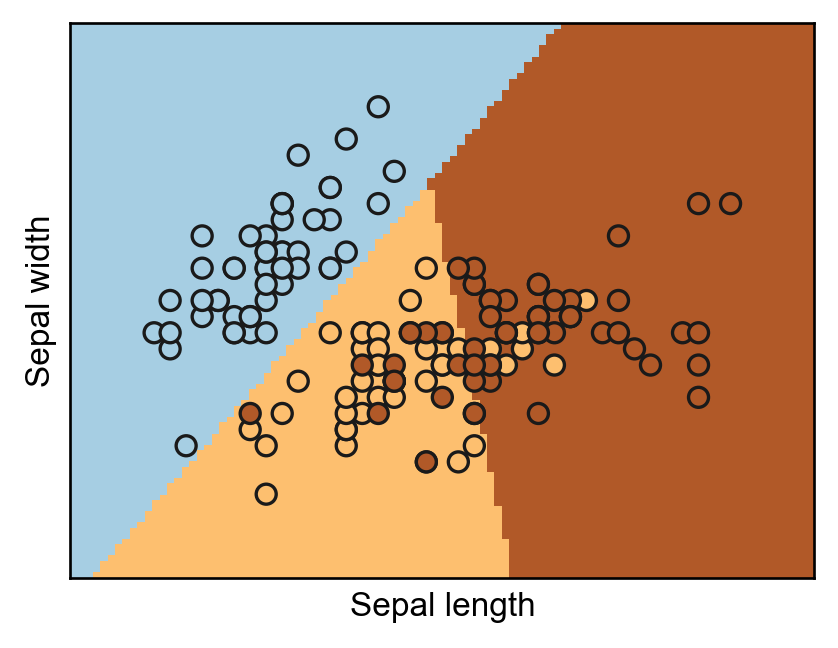

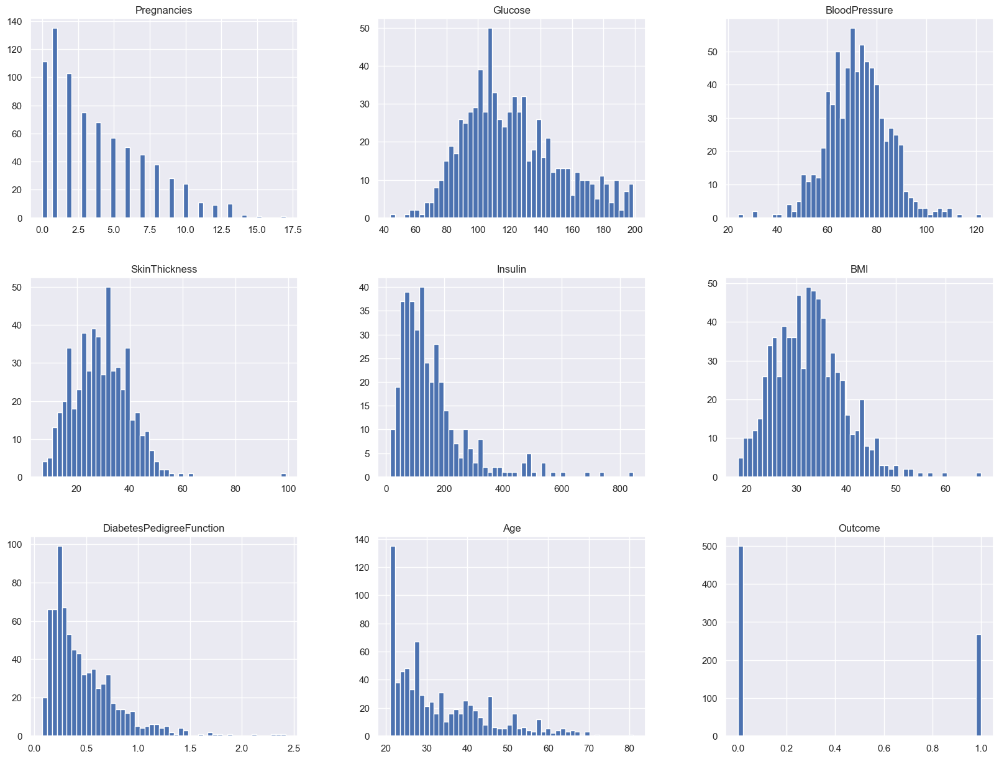

In [26]:
_ = df.hist(bins=50, figsize=(20, 15))

<Axes: >

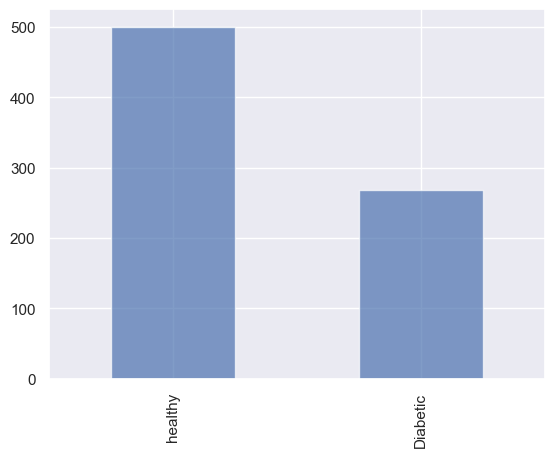

In [27]:
Healthy =  df[ df['Outcome'] == 0 ]
Diabetic = df[ df['Outcome'] == 1 ]

h_diab = pd.Series({'healthy':Healthy.shape[0],
            'Diabetic':Diabetic.shape[0]})
h_diab.plot.bar(alpha=0.7)

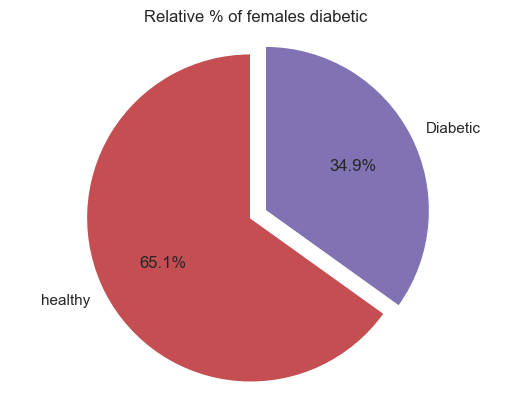

In [28]:
h_diab.plot.pie(startangle=90, 
                explode=[0, 0.1],
                autopct='%1.1f%%',
                colors=['C3', 'C4'])
plt.title('Relative % of females diabetic ')
plt.ylabel('')
_ = plt.axis('equal')

In [29]:
df.isnull().sum()

Pregnancies                   0
Glucose                       5
BloodPressure                35
SkinThickness               227
Insulin                     374
BMI                          11
DiabetesPedigreeFunction      0
Age                           0
Outcome                       0
dtype: int64

In [30]:
df.pivot_table(index=['Outcome'] )

,Age,BMI,BloodPressure,DiabetesPedigreeFunction,Glucose,Insulin,Pregnancies,SkinThickness
Outcome,,,,,,,,
0,31.190000,30.859674,70.877339,0.429734,110.643863,130.287879,3.298000,27.235457
1,37.067164,35.406767,75.321429,0.550500,142.319549,206.846154,4.865672,33.000000


In [31]:
def replace_null_values(df):
    for col in df.columns:
        df.loc[(df['Outcome']==0) & (df[col].isnull()), col] = df[df['Outcome'] == 0][col].median()
        df.loc[(df['Outcome']==1) & (df[col].isnull()), col] = df[ df['Outcome'] == 1][col].median()
    print(df.isnull().sum())
    
replace_null_values(df)

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64


In [32]:
# Feature Engineering

def create_new_bmi(df):
    new_cat = "NEW_BMI_CAT"
    df.loc[(df['BMI'] < 18.5), new_cat] = "underweight"
    df.loc[(df['BMI'] > 18.5) & (df['BMI'] < 25), new_cat] = "normal"
    df.loc[(df['BMI'] > 24) & (df['BMI'] < 30), new_cat] =  "overweight"
    df.loc[(df['BMI'] > 30) & (df['BMI']< 40), new_cat] = "obese"
    df.drop('BMI', axis=1, inplace=True)
    df[new_cat] = df[new_cat].astype('category')

def create_new_glucose(df): 
    new_cat = "NEW_GLUCOSE_CAT"
    df.loc[(df['Glucose'] < 70), new_cat] = "low"
    df.loc[(df['Glucose'] > 70) & (df['Glucose'] < 99), new_cat] = "normal"
    df.loc[(df['Glucose'] > 99) & (df['Glucose'] < 126), new_cat] = "high"
    df.loc[(df['Glucose'] > 126) & (df['Glucose'] < 200), new_cat] = "very_high"
    df[new_cat] = df[new_cat].astype('category')


def create_new_skinthickness(df):
    new_cat = "NEW_SKIN_THICKNESS"
    df.loc[df['SkinThickness'] < 30, new_cat] = "normal"
    df.loc[df['SkinThickness'] >= 70, new_cat] = "highfat"
    df[new_cat] = df[new_cat].astype('category')

def create_new_pregnancies(df):
    new_cat = "NEW_PREGNANCIES"
    df.loc[df['Pregnancies'] == 0, new_cat] = "no_pregnancies"
    df.loc[(df['Pregnancies'] > 0) & df['Pregnancies'] <= 4, new_cat] = "std_pregnancies"
    df.loc[(df['Pregnancies'] > 4), new_cat] = "over_pregnancies"
    df[new_cat] = df[new_cat].astype('category')

def create_circulation_level(df): 
    new_cat = "NEW_CIRCULATION_LEVEL"
    df.loc[(df['SkinThickness'] < 30) & (df['BloodPressure'] < 80), new_cat] = "normal"
    df.loc[(df['SkinThickness'] > 30) & (df['BloodPressure']>= 80), new_cat] = "high_risk"
    df.loc[((df['SkinThickness']< 30) & (df['BloodPressure'] >=80)) | ((df['SkinThickness']> 30) & (df['BloodPressure'] <80)), new_cat] = "medium_risk"
    df[new_cat] = df[new_cat].astype('category')
    df.drop('SkinThickness', axis=1, inplace=True)
    
def create_other_features(df):
    df['PRE_AGE_CAT'] = df['Age'] * df['Pregnancies']
    df['INSULIN_GLUCOSE_CAT'] = df['Insulin'] * df['Glucose']
    df.drop('Pregnancies', axis=1, inplace=True)
    df.drop('Glucose', axis=1, inplace=True)
    
create_new_bmi(df)
create_new_glucose(df)
create_new_pregnancies(df)
create_new_skinthickness(df)
create_circulation_level(df)
create_other_features(df)
df

,BloodPressure,Insulin,DiabetesPedigreeFunction,Age,Outcome,NEW_BMI_CAT,NEW_GLUCOSE_CAT,NEW_PREGNANCIES,NEW_SKIN_THICKNESS,NEW_CIRCULATION_LEVEL,PRE_AGE_CAT,INSULIN_GLUCOSE_CAT
0,72.0,169.5,0.627,50,1,obese,very_high,over_pregnancies,NaN,medium_risk,300,25086.0
1,66.0,102.5,0.351,31,0,overweight,normal,std_pregnancies,normal,normal,31,8712.5
2,64.0,169.5,0.672,32,1,normal,very_high,over_pregnancies,NaN,medium_risk,256,31018.5
3,66.0,94.0,0.167,21,0,overweight,normal,std_pregnancies,normal,normal,21,8366.0
4,40.0,168.0,2.288,33,1,NaN,very_high,std_pregnancies,NaN,medium_risk,0,23016.0
...,...,...,...,...,...,...,...,...,...,...,...,...
763,76.0,180.0,0.171,63,0,obese,high,over_pregnancies,NaN,medium_risk,630,18180.0
764,70.0,102.5,0.340,27,0,obese,high,std_pregnancies,normal,normal,54,12505.0
765,72.0,112.0,0.245,30,0,overweight,high,over_pregnancies,normal,normal,150,13552.0
766,60.0,169.5,0.349,47,1,obese,NaN,std_pregnancies,NaN,medium_risk,47,21357.0


In [33]:
# Label Encoding
df['NEW_CIRCULATION_LEVEL'].dtype.name == 'category'

True

In [34]:
len(df['NEW_CIRCULATION_LEVEL'].unique())

4

In [35]:
label_encoder = preprocessing.LabelEncoder()
df['Outcome'] = label_encoder.fit_transform(df['Outcome'])

In [36]:
categ_cols = [col for col in df.columns if df[col].dtype.name == 'category']
print(categ_cols)

['NEW_BMI_CAT', 'NEW_GLUCOSE_CAT', 'NEW_PREGNANCIES', 'NEW_SKIN_THICKNESS', 'NEW_CIRCULATION_LEVEL']


In [37]:
def one_hot_encoder(df, columns):
    df_dummy = df.copy()
    df_dummy = pd.get_dummies(df, columns=columns, drop_first=True)
    return df_dummy

result = one_hot_encoder(df, categ_cols)
result

,BloodPressure,Insulin,DiabetesPedigreeFunction,Age,Outcome,PRE_AGE_CAT,INSULIN_GLUCOSE_CAT,NEW_BMI_CAT_obese,NEW_BMI_CAT_overweight,NEW_BMI_CAT_underweight,NEW_GLUCOSE_CAT_low,NEW_GLUCOSE_CAT_normal,NEW_GLUCOSE_CAT_very_high,NEW_PREGNANCIES_std_pregnancies,NEW_SKIN_THICKNESS_normal,NEW_CIRCULATION_LEVEL_medium_risk,NEW_CIRCULATION_LEVEL_normal
0,72.0,169.5,0.627,50,1,300,25086.0,True,False,False,False,False,True,False,False,True,False
1,66.0,102.5,0.351,31,0,31,8712.5,False,True,False,False,True,False,True,True,False,True
2,64.0,169.5,0.672,32,1,256,31018.5,False,False,False,False,False,True,False,False,True,False
3,66.0,94.0,0.167,21,0,21,8366.0,False,True,False,False,True,False,True,True,False,True
4,40.0,168.0,2.288,33,1,0,23016.0,False,False,False,False,False,True,True,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,76.0,180.0,0.171,63,0,630,18180.0,True,False,False,False,False,False,False,False,True,False
764,70.0,102.5,0.340,27,0,54,12505.0,True,False,False,False,False,False,True,True,False,True
765,72.0,112.0,0.245,30,0,150,13552.0,False,True,False,False,False,False,False,True,False,True
766,60.0,169.5,0.349,47,1,47,21357.0,True,False,False,False,False,False,True,False,True,False


In [38]:
# Model Training

from sklearn.model_selection import train_test_split

X = result.drop('Outcome', axis=1)
y = df['Outcome']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [39]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error

rmse  = lambda labels, predictions: np.sqrt(mean_squared_error(labels, predictions))

lg_model = LogisticRegression(max_iter=1000,C=0.01).fit(X_train, y_train)
lg_predictions = lg_model.predict(X_test)
rmse(y_test, lg_predictions)

/opt/anaconda3/envs/comp_astro/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.4558423058385518

In [40]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import recall_score

print(accuracy_score(y_test, lg_predictions))
print(roc_auc_score(y_test, lg_predictions))

0.7922077922077922
0.7535353535353535


In [41]:
from sklearn.metrics import classification_report

print(classification_report(y_test, lg_predictions))

              precision    recall  f1-score   support

           0       0.81      0.89      0.85        99
           1       0.76      0.62      0.68        55

    accuracy                           0.79       154
   macro avg       0.78      0.75      0.76       154
weighted avg       0.79      0.79      0.79       154



In [42]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {'n_estimators': [400, 500, 600], 
              'max_leaf_nodes': [14, 15, 16]}
random_forest = RandomForestClassifier(n_jobs=-1)

grid_search_rf = GridSearchCV(random_forest, 
                              param_grid=param_grid, 
                              cv=3,
                              scoring='recall',
                              return_train_score=True)
grid_search_rf.fit(X_train, y_train)
grid_search_rf.best_params_

{'max_leaf_nodes': 14, 'n_estimators': 500}

In [43]:
print(classification_report(y_test, grid_search_rf.predict(X_test)))
print(recall_score(y_test, grid_search_rf.predict(X_test)))
print(roc_auc_score(y_test, grid_search_rf.predict_proba(X_test)[:, 1]))

              precision    recall  f1-score   support

           0       0.89      0.86      0.87        99
           1       0.76      0.80      0.78        55

    accuracy                           0.84       154
   macro avg       0.82      0.83      0.83       154
weighted avg       0.84      0.84      0.84       154

0.8
0.9248852157943067


# Artificial Neural Network Classifier

In [21]:
import torch
from torch import nn
from torch.nn import functional as F

from torch.utils.data import DataLoader # loads data in batches
from torchvision import datasets # load MNIST
import torchvision.transforms as T # transformers for computer vision 
from torchvision import datasets
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm # progress bar

In [22]:
mytransform = T.ToTensor() # image (3D array) to Tensor

train_data = datasets.MNIST(root = './', download=True, train = True, transform = mytransform)
test_data = datasets.MNIST(root = './', download=True, train = False, transform = mytransform)

img, label = train_data[0]
img.shape # returns a Tensor of Size 1,28,28


Failed to download (trying next):
<urlopen error [Errno 60] Operation timed out>



100%|██████████| 9.91M/9.91M [00:18<00:00, 537kB/s]


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [Errno 60] Operation timed out>



100%|██████████| 28.9k/28.9k [00:00<00:00, 271kB/s]


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [Errno 60] Operation timed out>



100%|██████████| 1.65M/1.65M [00:06<00:00, 258kB/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [Errno 60] Operation timed out>



100%|██████████| 4.54k/4.54k [00:00<00:00, 1.35MB/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



torch.Size([1, 28, 28])

In [24]:
# We could simply plot the tensor
plt.imshow(img.reshape(28,28), cmap = 'gist_yarg'); # gist_yarg plots inverse of W&B
plt.axis('off')

(-0.5, 27.5, 27.5, -0.5)

In [25]:
torch.manual_seed(101)

train_loader = DataLoader(train_data, batch_size = 100, shuffle=True)
# the test loader can be bigger and doesn't need to be shuffled
test_loader =  DataLoader(test_data,  batch_size = 500, shuffle=False) 

In [26]:
from dataclasses import dataclass

@dataclass
class Loader:
    """
    Custom class to accomodate train and test loader iterators
    """
    train: DataLoader  # train DataLoader iterable object
    test:  DataLoader  # test DataLoader iterable object
    
myloader = Loader(train = train_loader, test = test_loader)    
print(myloader)

# Plot 10 images
for img, label in myloader.train:
    break # we run only one iteration , after that we break, we need it jus to see the shape
img.shape # bz, ch, W H

Loader(train=<torch.utils.data.dataloader.DataLoader object at 0x1777abc40>, test=<torch.utils.data.dataloader.DataLoader object at 0x176a3af80>)


torch.Size([100, 1, 28, 28])

In [27]:
myimages = img[:50].numpy() # we now obtain NumPy arrays
print(f"My Images shape: ", myimages.shape)

print("Transpose Images shape: ", myimages[0].transpose(1,2,0).shape) # height, width, channel


My Images shape:  (50, 1, 28, 28)
Transpose Images shape:  (28, 28, 1)


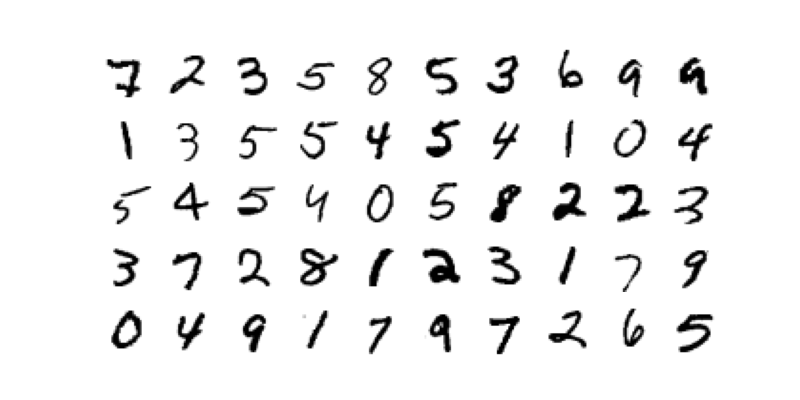

In [28]:
fig, ax = plt.subplots(nrows = 5, ncols = 10, figsize=(8,4), subplot_kw={'xticks': [], 'yticks': []})
for row in range(0,5):
    for col in range(0,10):
        myid = (10*row) + col # (ncols*rows) + cols
        
        ax[row,col].imshow( myimages[myid].transpose(1,2,0), cmap = 'gist_yarg' ) # W,H,C
        ax[row,col].axis('off')



In [29]:
class MultilayerPerceptron(nn.Module):
    """
    A simple multilayer perceptron network 
   
    """
    def __init__(self, in_features = 784, out_features=10):
        """
        * 784 input layers 
        * 2 hiden layers of 120 and 84 neurons respectively
        * 10 output layer
        """
        super(MultilayerPerceptron, self).__init__()
        
        self.fc1 = nn.Linear(in_features, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, out_features)
            
    def forward(self, X):
        
        X = F.relu(self.fc1(X)) # Rectified Linear Unit (ReLU)
        X = F.relu(self.fc2(X)) # Rectified Linear Unit (ReLU)
        X = self.fc3(X)
        
        return F.log_softmax(X, dim = 1) # multi-class classification, the sum of all probabilities 

In [30]:
torch.manual_seed(101)

mymodel = MultilayerPerceptron() # default params are in_features = 784, out_features=10
mymodel # check topology

MultilayerPerceptron(
  (fc1): Linear(in_features=784, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
)

In [31]:
criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(mymodel.parameters(), lr = 1e-3)

In [32]:
params = [p.numel() for p in mymodel.parameters() if p.requires_grad]
np.sum(params)

105214

In [33]:
# Plot 10 images
myiter = iter(myloader.train)
img, label = myiter.__next__() # only one iteration
img.shape # batch_size, channel, Height, Width

torch.Size([100, 1, 28, 28])

In [34]:
img.view(100,-1).shape # 100 batches of 784 pixels

torch.Size([100, 784])

In [35]:
y_pred = mymodel( img.view(100,-1) )
y_pred.shape # 100 x 10, meaning for every batch (100) we obtain  (10 probabilities) predictions 

torch.Size([100, 10])

In [36]:
val, idx = torch.max(y_pred, dim=1) # dim 1 is for the output
idx # indices == predictions

tensor([2, 2, 2, 2, 8, 2, 2, 8, 2, 6, 8, 8, 8, 8, 8, 8, 8, 2, 6, 2, 8, 2, 2, 2,
        8, 2, 6, 8, 6, 2, 6, 8, 2, 2, 8, 7, 6, 6, 2, 2, 2, 8, 2, 2, 6, 6, 8, 8,
        8, 2, 2, 7, 8, 6, 2, 8, 2, 2, 2, 6, 2, 2, 2, 6, 7, 2, 8, 8, 6, 6, 2, 8,
        2, 6, 7, 8, 6, 8, 6, 2, 2, 2, 2, 2, 2, 6, 8, 8, 2, 8, 6, 2, 2, 6, 2, 2,
        8, 8, 2, 2])

In [37]:
# tracking variables

class Loss:
    """ Class to monitor train and test lost"""
    train: list = []
    test: list = []
    

class Accuracy:
    """ Class to monitor train and test accuracy"""
    train: list = []
    test: list = []


In [38]:
%%time

epochs = 10
for epoch in tqdm(range(epochs)):
    # we set the number of True positives to zero in every epoch
    train_corr = 0
    test_corr = 0
    
    # training: we run the train dataset in batches of 100 images, meaning that run the loader 600 times (600 x 100 = 60,000 images)
    for batch, (img, label) in enumerate(myloader.train): 
        batch +=1
        y_pred = mymodel( img.view(100,-1) ) # batch size for train is 100
        loss = criterion(y_pred, label)
        
        # last 10-layer neurons into one result
        _, prediction = torch.max(y_pred,dim = 1)
        train_corr += (prediction == label).sum() # sum of correct predictions

        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # monitor loss and accuracy every 200 train batches of 100 images ( 3 times per epoch)
        if batch%200 == 0:
            acc = 100 * (train_corr.item() / (batch*100) ) # correct predictions divided by images in batches 
            print( f'Epoch:{epoch:2d} batch: {batch:2d} loss: {loss.item():4.4f} Accuracy: {acc:4.4f} %' )

    Loss.train.append( loss.item() ) # store loss at the end of epoch
    accuracy = 100 * (train_corr.item() / (batch*100) ) # accuracy is 100 x train_corr.item()/60_000
    Accuracy.train.append( accuracy ) # store accuracy at the end of epoch

    
    # validation (test). Here we run batches of 500 images, the test loader runs 120 times (120 x 500 = 60,000)
    with torch.no_grad():
        for batch, (img, label) in enumerate(myloader.test):
            batch +=1
            y_val = mymodel( img.view(500,-1) ) # batch size for test is 500
            _, predicted = torch.max( y_val, dim = 1)
            test_corr += (predicted == label).sum()
    
    loss = criterion( y_val,label )
    Loss.test.append( loss.item() ) 
    accuracy = 100 * (test_corr.item()/ (batch*500) ) # accuracy is 100 x train_corr.item()/60,000
    Accuracy.test.append( accuracy )

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 0 batch: 200 loss: 0.2996 Accuracy: 82.6550 %
Epoch: 0 batch: 400 loss: 0.2726 Accuracy: 87.2475 %
Epoch: 0 batch: 600 loss: 0.1818 Accuracy: 89.3150 %


 10%|█         | 1/10 [00:02<00:21,  2.41s/it]

Epoch: 1 batch: 200 loss: 0.1696 Accuracy: 94.6350 %
Epoch: 1 batch: 400 loss: 0.0531 Accuracy: 95.0325 %
Epoch: 1 batch: 600 loss: 0.1431 Accuracy: 95.2533 %


 20%|██        | 2/10 [00:04<00:19,  2.39s/it]

Epoch: 2 batch: 200 loss: 0.1664 Accuracy: 96.5100 %
Epoch: 2 batch: 400 loss: 0.1725 Accuracy: 96.5300 %
Epoch: 2 batch: 600 loss: 0.1110 Accuracy: 96.5983 %


 30%|███       | 3/10 [00:07<00:16,  2.37s/it]

Epoch: 3 batch: 200 loss: 0.1471 Accuracy: 97.3700 %
Epoch: 3 batch: 400 loss: 0.0118 Accuracy: 97.4525 %
Epoch: 3 batch: 600 loss: 0.0899 Accuracy: 97.4000 %


 40%|████      | 4/10 [00:09<00:14,  2.38s/it]

Epoch: 4 batch: 200 loss: 0.0584 Accuracy: 98.0350 %
Epoch: 4 batch: 400 loss: 0.1055 Accuracy: 97.9400 %
Epoch: 4 batch: 600 loss: 0.0947 Accuracy: 97.9733 %


 50%|█████     | 5/10 [00:12<00:12,  2.41s/it]

Epoch: 5 batch: 200 loss: 0.0879 Accuracy: 98.5200 %
Epoch: 5 batch: 400 loss: 0.0231 Accuracy: 98.4175 %
Epoch: 5 batch: 600 loss: 0.0363 Accuracy: 98.3350 %


 60%|██████    | 6/10 [00:14<00:09,  2.39s/it]

Epoch: 6 batch: 200 loss: 0.0304 Accuracy: 98.8850 %
Epoch: 6 batch: 400 loss: 0.0299 Accuracy: 98.7175 %
Epoch: 6 batch: 600 loss: 0.0295 Accuracy: 98.7050 %


 70%|███████   | 7/10 [00:16<00:07,  2.39s/it]

Epoch: 7 batch: 200 loss: 0.0036 Accuracy: 99.0250 %
Epoch: 7 batch: 400 loss: 0.0101 Accuracy: 98.9075 %
Epoch: 7 batch: 600 loss: 0.0256 Accuracy: 98.8433 %


 80%|████████  | 8/10 [00:19<00:04,  2.38s/it]

Epoch: 8 batch: 200 loss: 0.0119 Accuracy: 99.2300 %
Epoch: 8 batch: 400 loss: 0.0836 Accuracy: 99.1950 %
Epoch: 8 batch: 600 loss: 0.0697 Accuracy: 99.1383 %


 90%|█████████ | 9/10 [00:21<00:02,  2.37s/it]

Epoch: 9 batch: 200 loss: 0.0270 Accuracy: 99.3550 %
Epoch: 9 batch: 400 loss: 0.0395 Accuracy: 99.3300 %
Epoch: 9 batch: 600 loss: 0.0230 Accuracy: 99.2550 %


100%|██████████| 10/10 [00:23<00:00,  2.38s/it]

CPU times: user 1min 50s, sys: 7.1 s, total: 1min 57s
Wall time: 23.8 s


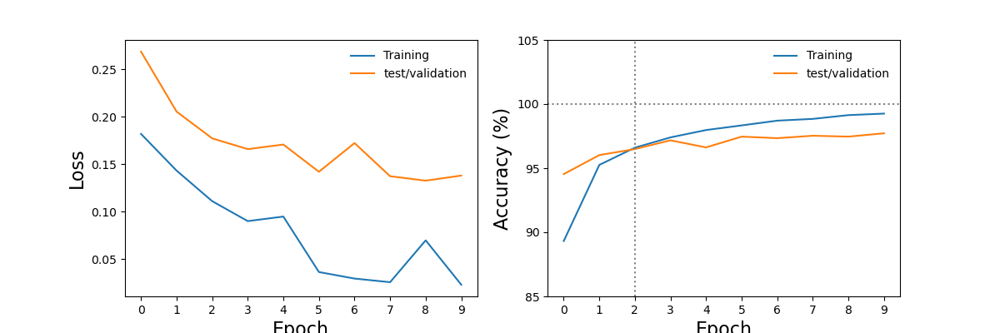

In [39]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,4))
ax[0].plot(Loss.train, label = 'Training')
ax[0].plot(Loss.test, label='test/validation')
ax[0].set_ylabel('Loss', fontsize=16)


ax[1].plot(Accuracy.train, label = 'Training')
ax[1].plot(Accuracy.test, label='test/validation')
ax[1].set_yticks(range(85,110,5))
ax[1].axvline(x=2, color='gray', linestyle=':')
ax[1].axhline(y=100, color='gray', linestyle=':')
ax[1].set_ylabel('Accuracy (%)', fontsize=16)

for myax in ax:
    myax.set_xlabel('Epoch', fontsize=16)
    myax.set_xticks(range(epochs))
    myax.legend(frameon=False)

In [40]:
test_loader =  DataLoader(test_data,  batch_size = 10_000, shuffle=False) # the whole test is 10,000 images
myiter = iter(test_loader)
img, label = myiter.__next__()
img.shape

torch.Size([10000, 1, 28, 28])

In [41]:
with torch.no_grad():
    correct = 0
    
    for X, y_label in test_loader:
            y_val = mymodel( X.view(X.shape[0],-1) ) # flatten
            _, predicted = torch.max( y_val, dim = 1)
            correct += (predicted == y_label).sum()

print(f'Test accuracy: = {correct.item()*100/(len(test_data)):2.4f} %')

Test accuracy: = 97.7200 %


In [42]:
from sklearn.metrics import confusion_matrix  # for evaluating results
confusion_array = confusion_matrix(y_true = y_label,y_pred = predicted)
confusion_array

array([[ 970,    0,    2,    2,    0,    0,    4,    0,    1,    1],
       [   0, 1125,    3,    2,    0,    0,    2,    0,    3,    0],
       [   1,    0, 1019,    2,    1,    0,    2,    4,    2,    1],
       [   2,    0,    9,  984,    0,    1,    1,    4,    9,    0],
       [   0,    1,    6,    1,  951,    0,    8,    3,    3,    9],
       [   2,    0,    0,   13,    1,  858,   10,    0,    7,    1],
       [   2,    2,    3,    1,    2,    2,  945,    0,    1,    0],
       [   0,    7,   10,    1,    0,    0,    0, 1001,    4,    5],
       [   3,    0,    3,    2,    0,    2,    4,    2,  956,    2],
       [   5,    3,    0,    9,    9,    8,    1,    3,    8,  963]])

<Axes: >

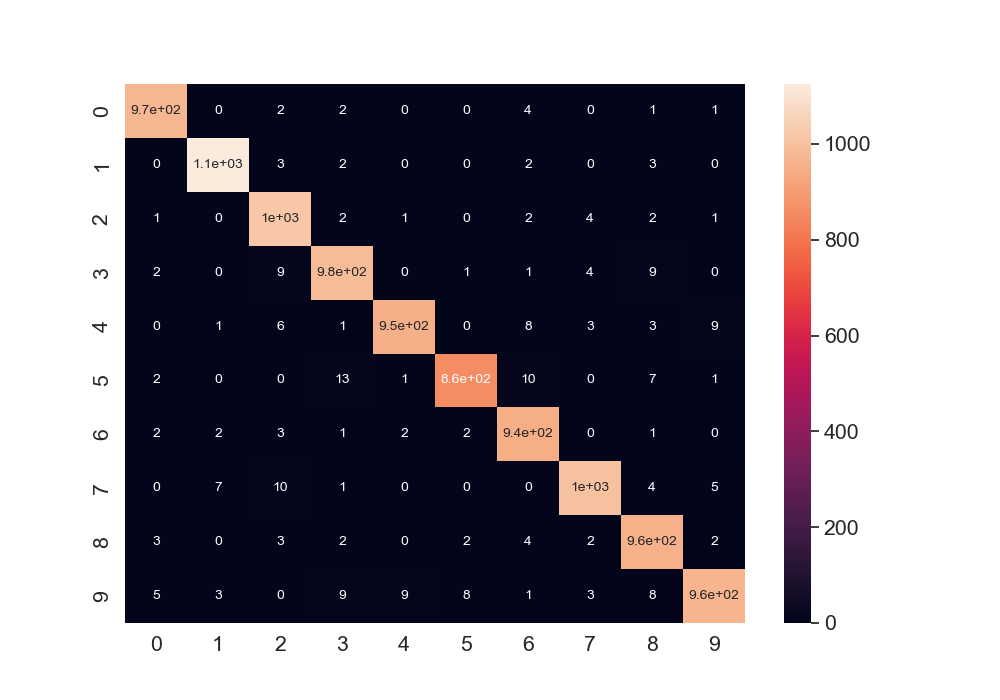

In [43]:
import pandas as pd
import seaborn as sn
df_cm = pd.DataFrame(confusion_array, range(10), range(10))
plt.figure(figsize=(10,7))
sn.set_theme(font_scale=1.4) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 10}) # font size

# Classifier Comparison

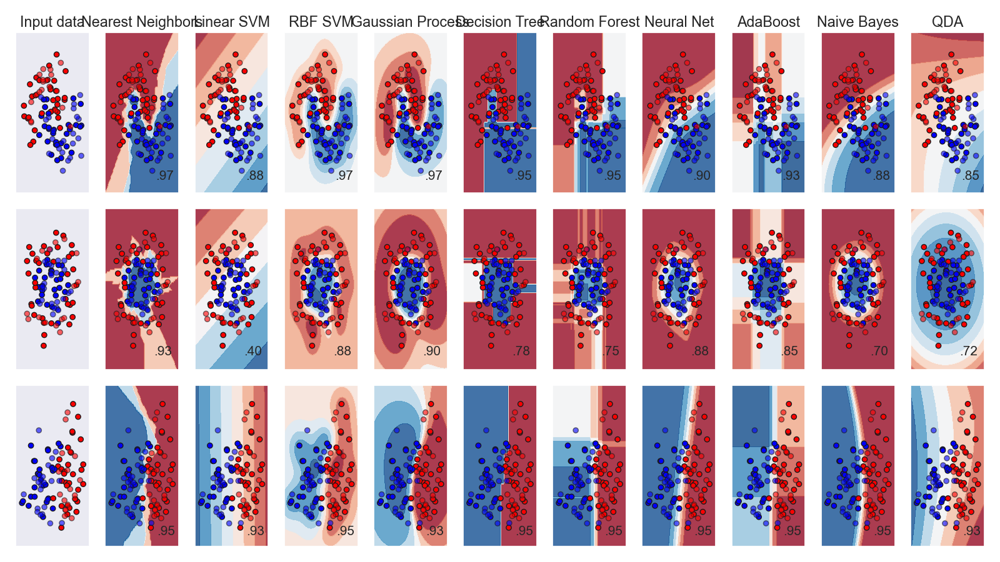

In [44]:
# Code source: Gaël Varoquaux
#              Andreas Müller
# Modified for documentation by Jaques Grobler
# License: BSD 3 clause

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

from sklearn.datasets import make_circles, make_classification, make_moons
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier

names = [
    "Nearest Neighbors",
    "Linear SVM",
    "RBF SVM",
    "Gaussian Process",
    "Decision Tree",
    "Random Forest",
    "Neural Net",
    "AdaBoost",
    "Naive Bayes",
    "QDA",
]

classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025, random_state=42),
    SVC(gamma=2, C=1, random_state=42),
    GaussianProcessClassifier(1.0 * RBF(1.0), random_state=42),
    DecisionTreeClassifier(max_depth=5, random_state=42),
    RandomForestClassifier(
        max_depth=5, n_estimators=10, max_features=1, random_state=42
    ),
    MLPClassifier(alpha=1, max_iter=1000, random_state=42),
    AdaBoostClassifier(algorithm="SAMME", random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
]

X, y = make_classification(
    n_features=2, n_redundant=0, n_informative=2, random_state=1, n_clusters_per_class=1
)
rng = np.random.RandomState(2)
X += 2 * rng.uniform(size=X.shape)
linearly_separable = (X, y)

datasets = [
    make_moons(noise=0.3, random_state=0),
    make_circles(noise=0.2, factor=0.5, random_state=1),
    linearly_separable,
]

figure = plt.figure(figsize=(16, 9))
i = 1
# iterate over datasets
for ds_cnt, ds in enumerate(datasets):
    # preprocess dataset, split into training and test part
    X, y = ds
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.4, random_state=42
    )

    x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
    y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

    # just plot the dataset first
    cm = plt.cm.RdBu
    cm_bright = ListedColormap(["#FF0000", "#0000FF"])
    ax = plt.subplot(len(datasets), len(classifiers) + 1, i)
    if ds_cnt == 0:
        ax.set_title("Input data")
    # Plot the training points
    ax.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k")
    # Plot the testing points
    ax.scatter(
        X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.6, edgecolors="k"
    )
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.set_xticks(())
    ax.set_yticks(())
    i += 1

    # iterate over classifiers
    for name, clf in zip(names, classifiers):
        ax = plt.subplot(len(datasets), len(classifiers) + 1, i)

        clf = make_pipeline(StandardScaler(), clf)
        clf.fit(X_train, y_train)
        score = clf.score(X_test, y_test)
        DecisionBoundaryDisplay.from_estimator(
            clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
        )

        # Plot the training points
        ax.scatter(
            X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
        )
        # Plot the testing points
        ax.scatter(
            X_test[:, 0],
            X_test[:, 1],
            c=y_test,
            cmap=cm_bright,
            edgecolors="k",
            alpha=0.6,
        )

        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        ax.set_xticks(())
        ax.set_yticks(())
        if ds_cnt == 0:
            ax.set_title(name)
        ax.text(
            x_max - 0.3,
            y_min + 0.3,
            ("%.2f" % score).lstrip("0"),
            size=15,
            horizontalalignment="right",
        )
        i += 1

plt.tight_layout()
plt.show()

# CNN Classifier

Let's buil a classifier from the [CIFAR-10 dataset](https://paperswithcode.com/dataset/cifar-10 "Canadian Institute for Advanced Research, 10 classes").

In [45]:
# Import the libraries
import torch
import torchvision
import torchvision.transforms as transforms

In [46]:
# Let's see the device available on the machine 
# For a macbook with  Mx processor, use the second line
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# device = torch.device('mps')

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cpu


In [47]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 4

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)

classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

100%|██████████| 170M/170M [02:53<00:00, 981kB/s]  


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


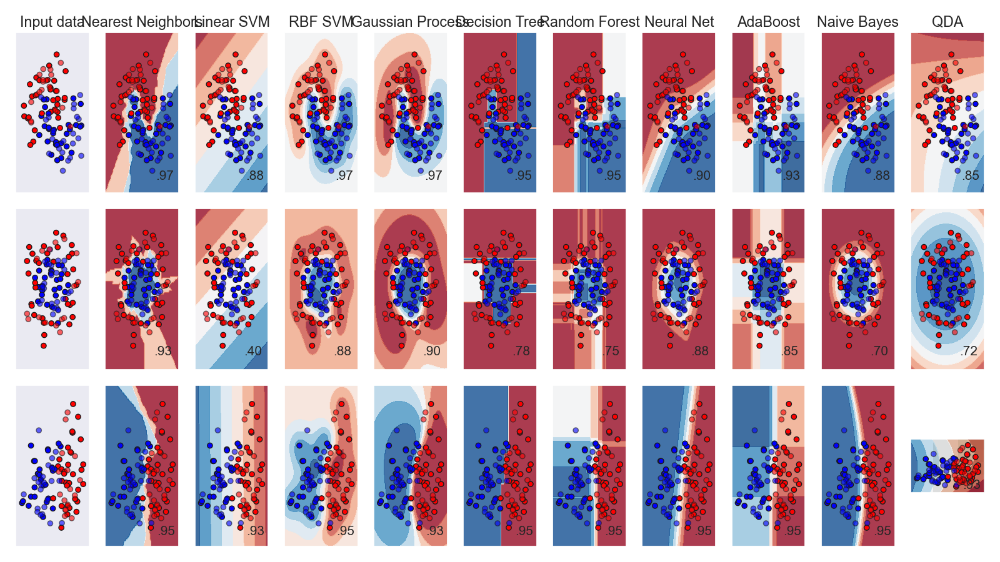

bird  truck ship  bird 


In [50]:
# Let's show some of the training images
import matplotlib.pyplot as plt
import numpy as np

# functions to show an image


def imshow(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()


# get some random training images
dataiter = iter(trainloader)
images, labels = next(dataiter)

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join(f'{classes[labels[j]]:5s}' for j in range(batch_size)))

In [51]:
# Define the convolutional network
import torch.nn as nn
import torch.nn.functional as F


class Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 5 * 5, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = torch.flatten(x, 1) # flatten all dimensions except batch
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net().to(device)


In [52]:
# Define the losso function
import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

In [53]:
# Train the network
for epoch in range(2):  # loop over the dataset multiple times

    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data[0].to(device), data[1].to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        if i % 2000 == 1999:    # print every 2000 mini-batches
            print(f'[{epoch + 1}, {i + 1:5d}] loss: {running_loss / 2000:.3f}')
            running_loss = 0.0

print('Finished Training')

[1,  2000] loss: 2.216
[1,  4000] loss: 1.924
[1,  6000] loss: 1.697
[1,  8000] loss: 1.591
[1, 10000] loss: 1.527
[1, 12000] loss: 1.486
[2,  2000] loss: 1.404
[2,  4000] loss: 1.366
[2,  6000] loss: 1.360
[2,  8000] loss: 1.333
[2, 10000] loss: 1.326
[2, 12000] loss: 1.283
Finished Training


In [9]:
# Let's save our trained model
PATH = './cifar_net.pth'
torch.save(net.state_dict(), PATH)

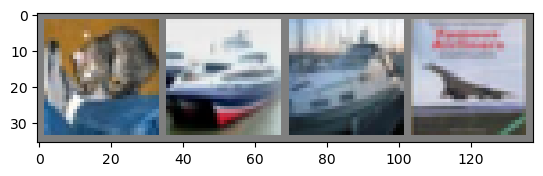

GroundTruth:  cat   ship  ship  plane


In [10]:
# Test the network on the test data
dataiter = iter(testloader)
images, labels = next(dataiter)

# print images
imshow(torchvision.utils.make_grid(images))
print('GroundTruth: ', ' '.join(f'{classes[labels[j]]:5s}' for j in range(4)))

In [11]:
# To load a trained model just use the following
net = Net()
net.load_state_dict(torch.load(PATH, weights_only=True))

<All keys matched successfully>

In [12]:
#Let's see what th neural network thinke these examples above are
outputs = net(images)

In [13]:
# Let's print them
_, predicted = torch.max(outputs, 1)

print('Predicted: ', ' '.join(f'{classes[predicted[j]]:5s}'
                              for j in range(4)))

Predicted:  cat   ship  ship  ship 


In [14]:
# Let's see how the network performs onn the whole dataset
correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in testloader:
        images, labels = data
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the 10000 test images: {100 * correct // total} %')

Accuracy of the network on the 10000 test images: 52 %


In [15]:
# It seems that the network learnt something, let's see the accuracy for each class
# prepare to count predictions for each class
correct_pred = {classname: 0 for classname in classes}
total_pred = {classname: 0 for classname in classes}

# again no gradients needed
with torch.no_grad():
    for data in testloader:
        images, labels = data
        outputs = net(images)
        _, predictions = torch.max(outputs, 1)
        # collect the correct predictions for each class
        for label, prediction in zip(labels, predictions):
            if label == prediction:
                correct_pred[classes[label]] += 1
            total_pred[classes[label]] += 1


# print accuracy for each class
for classname, correct_count in correct_pred.items():
    accuracy = 100 * float(correct_count) / total_pred[classname]
    print(f'Accuracy for class: {classname:5s} is {accuracy:.1f} %')

Accuracy for class: plane is 48.3 %
Accuracy for class: car   is 62.0 %
Accuracy for class: bird  is 63.7 %
Accuracy for class: cat   is 30.4 %
Accuracy for class: deer  is 35.1 %
Accuracy for class: dog   is 48.7 %
Accuracy for class: frog  is 46.6 %
Accuracy for class: horse is 53.3 %
Accuracy for class: ship  is 84.1 %
Accuracy for class: truck is 55.5 %


# Generative Adversarial Networks

In [54]:
# https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [55]:
# Root directory for dataset
dataroot = "/Users/tiziano/Dropbox/Computational Astrophysics/data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1


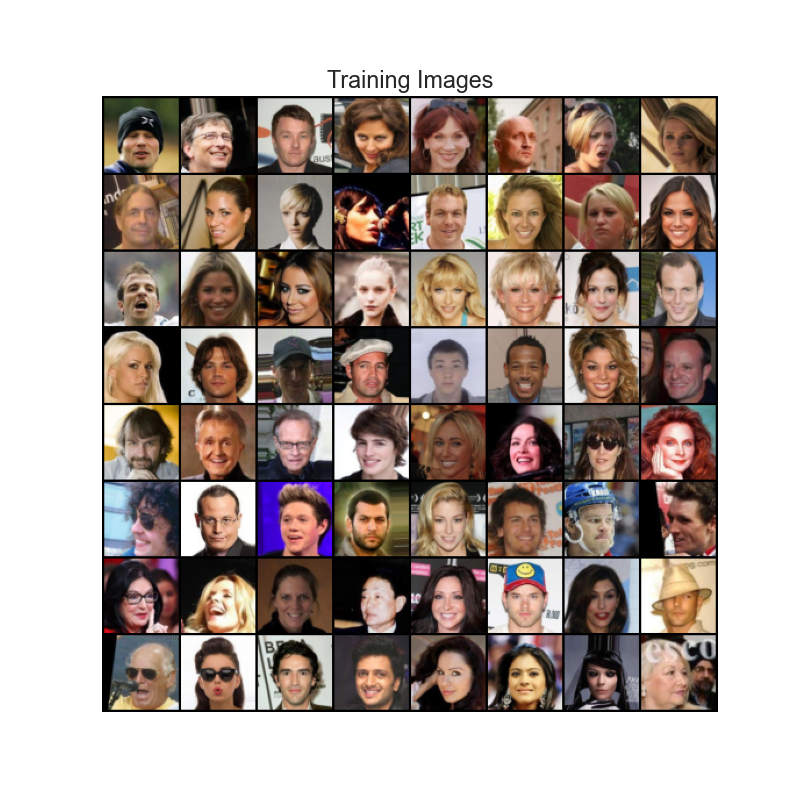

In [56]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [57]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [58]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [59]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [60]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [61]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [62]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [63]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.7227	Loss_G: 5.2589	D(x): 0.5542	D(G(z)): 0.5840 / 0.0080


KeyboardInterrupt: 

In [28]:
# np.save("./img_list.npy", img_list)

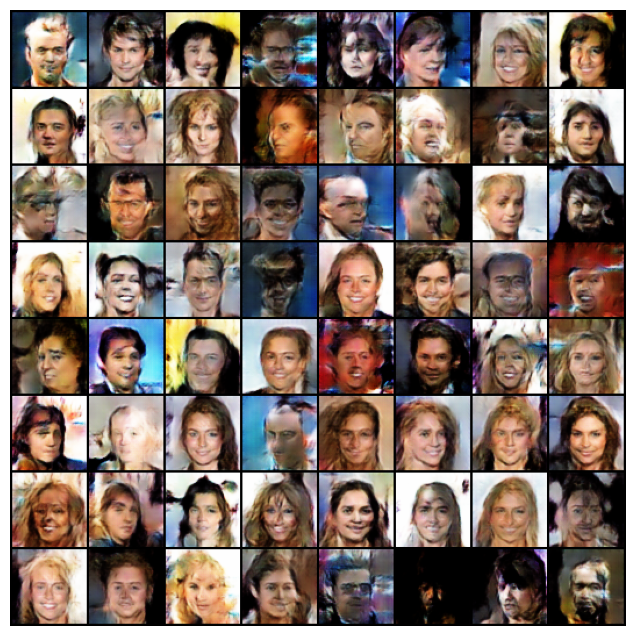

In [26]:
img_list_saved = np.load("./img_list.npy")
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_saved]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

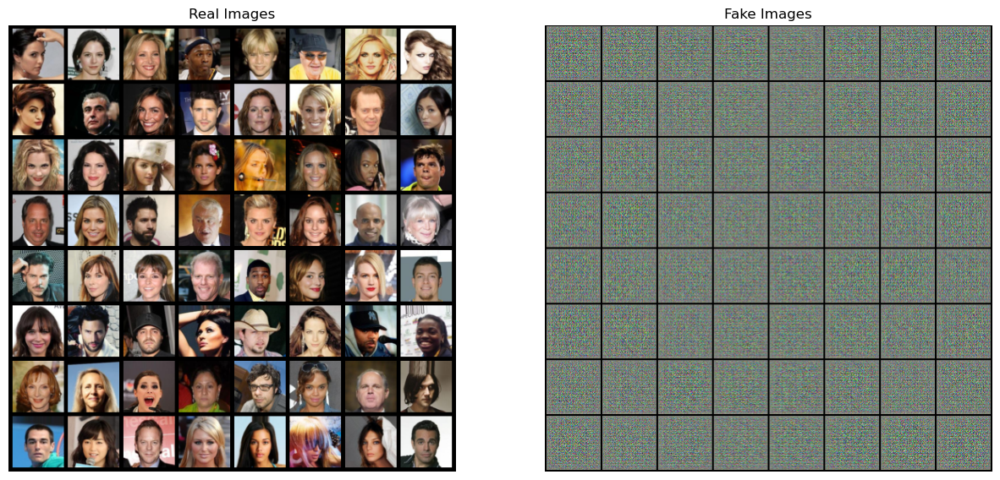

In [27]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()